In [1]:
import copy
import os
from typing import Any

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import polars as pl
import pyref.fitting as fit
from matplotlib.figure import Figure
from refnx.analysis import Transform

CPU_COUNT = (os.cpu_count() | 8)
CPU_COUNT

40

Dataset loaded from reflectivity_data.parquet


(<Axes: ylabel='$R$'>, <Axes: xlabel='$q (\\AA^{-1})$'>)

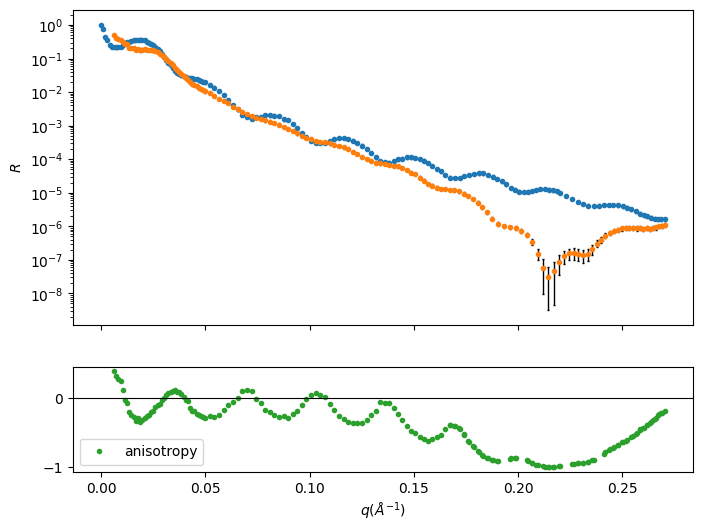

In [2]:
def load_reflectivity_dataset(filename):
    """
    Load reflectivity dataset from a parquet file.

    Parameters
    ----------
    filename : str
        Input filename (should be a .parquet file)

    Returns
    -------
    dict
        Dictionary containing XrayReflectDataset objects with energy keys
    """
    # Load the DataFrame
    df_load = pl.read_parquet(filename)

    # Reconstruct the data dictionary
    data_reconstructed = {}

    # Group by energy
    for group_key, group_data in df_load.group_by("energy"):
        energy_val = group_key[0]  # Extract energy value from the group key tuple
        #  If the R - dR is negative or zero, drop the point
        diff = group_data["R"] - group_data["dR"]
        mask = diff > 0
        group_data = group_data.filter(mask)

        # Extract arrays
        Q = group_data["Q"].to_numpy()
        R = group_data["R"].to_numpy()
        dR = group_data["dR"].to_numpy()

        # Create XrayReflectDataset
        dataset = fit.XrayReflectDataset(data=(Q, R, dR))
        data_reconstructed[str(energy_val)] = dataset

    print(f"Dataset loaded from {filename}")
    return data_reconstructed

loaded_data = load_reflectivity_dataset("reflectivity_data.parquet")
loaded_data["283.7"].plot(label="283.7 eV data")

In [3]:
import pickle

with open("fitting_results_fixed_3.pkl", "rb") as f:
    fitting_results = pickle.load(f)

In [4]:
def select(global_objective, slab, energy):
    for o in global_objective.objectives:
        if o.model.energy == energy:
            for s in o.model.structure.components:
                if s.name.startswith(slab):
                    return s
            raise ValueError(f"No slab {slab} found in energy {energy}")
    raise ValueError(f"No energy {energy} found in global objective")

select(fitting_results, "Surface", 283.7).thick.setp(bounds=(0, 35))
select(fitting_results, "Surface", 283.7).rough.setp(bounds=(0, 25))
select(fitting_results, "Surface", 283.7).sld.rotation.setp(bounds=(0, np.pi/2))
select(fitting_results, "Surface", 283.7).sld.density.setp(bounds=(.5, 2))

select(fitting_results, "ZnPc", 283.7).thick.setp(bounds=(160, 200))
select(fitting_results, "ZnPc", 283.7).rough.setp(bounds=(0, 25))
select(fitting_results, "ZnPc", 283.7).sld.rotation.setp(bounds=(np.deg2rad(55), np.deg2rad(90)))

select(fitting_results, "Contamination", 283.7).thick.setp(bounds=(0, 35))
select(fitting_results, "Contamination", 283.7).rough.setp(bounds=(0, 25))
select(fitting_results, "Contamination", 283.7).sld.rotation.setp(bounds=(0, np.pi/2))
select(fitting_results, "Contamination", 283.7).sld.density.setp(bounds=(.5, 2))

select(fitting_results, "Oxide", 283.7).thick.setp(bounds=(0, 20))
select(fitting_results, "Oxide", 283.7).rough.setp(bounds=(0, 25))

In [5]:
# Grab all the scale's and offsets and change their bounds
for p in fitting_results.varying_parameters():
    if p.name in ["scale_s", "scale_p"]:
        p.setp(bounds=(.5, 2))

# Grab the energy offset and set it to change
for o in fitting_results.objectives:
    if o.model.energy == 283.7:
        o.model.energy_offset.setp(vary=True, bounds=(-1, 1))

In [6]:
class LogpExtra:
    """Log Prior Constraint for the fitting of reflectometry data."""

    def __init__(self, objective):
        self.objective = objective

    def __call__(self, model, data):
        """Apply custom log-prior constraint."""
        interface_slabs = [1, 3]
        for i, slab in enumerate(model.structure.components):
            if i ==0 or i == len(model.structure.components) - 1:
                continue
            if slab.thick.value < 2 * np.sqrt(2 * np.pi) * slab.rough.value / 2:
                continue
                return -np.finfo(np.float64).max
        sio2 = model.structure.components[-2]
        si = model.structure.components[-1]
        if sio2.sld.density.value > si.sld.density.value:
            return -np.finfo(np.float64).max
        # surface = model.structure.components[1]
        # bulk = model.structure.components[2]
        # subsurface = model.structure.components[3]
        # if surface.sld.density.value > bulk.sld.density.value:
        #     return -np.finfo(np.float64).max
        # if subsurface.sld.density.value > bulk.sld.density.value:
        #     return -np.finfo(np.float64).max
        return 0

In [7]:
from typing import TypeVar

import dynesty
from refnx.analysis import process_chain

T = TypeVar("T", bound=fit.Objective | fit.AnisotropyObjective | fit.GlobalObjective)


def fit_dynamic(obj: T, CPU=CPU_COUNT, name = "",restart=False) -> tuple[T, dynesty.DynamicNestedSampler]:
    """Fit the model using dynamic nested sampling."""
    from datetime import datetime
    fname = f"dynesty_{name}_{datetime.now().strftime('%Y%m%d')}.save"

    objective: fit.Objective | fit.AnisotropyObjective | fit.GlobalObjective = (
        copy.deepcopy(obj)
    )

    ndim = len(objective.varying_parameters())
    nlive = 100 * ndim
    with dynesty.pool.Pool(CPU, objective.logl, objective.prior_transform) as pool:
        if restart:
            nested_sampler = dynesty.DynamicNestedSampler.restore(fname)
        else:
            nested_sampler = dynesty.DynamicNestedSampler(
                pool.loglike,
                pool.prior_transform,
                ndim=ndim,
                nlive=nlive,
                pool=pool,
        )
        nested_sampler.run_nested(resume=restart, checkpoint_file=fname)
    logZdynesty = nested_sampler.results.logz[-1]  # value of logZ
    weights = np.exp(nested_sampler.results.logwt - logZdynesty)
    chain = dynesty.utils.resample_equal(nested_sampler.results.samples, weights)
    process_chain(objective, chain[:, None, :])
    return objective, nested_sampler

In [8]:
def x0(fitter):
    o = fitter.objective
    p0 = o.varying_parameters()
    return np.array([o.value for o in p0])

def bounds(p, override_chain=False):
    if np.shape(p.chain) == () or override_chain:
        return (
            (p.value - p.stderr) * 0.8,
            (p.value + p.stderr) * 1.2
        )
    else:
        return (p.chain[-1].min() * 0.8, p.chain[-1].max() * 1.2)


def update_bounds(fitter, override_chain=False):
    p0 = fitter.objective.varying_parameters()
    for p in p0:

        if p.name.split("_")[-1] in ["rotation"]:
            continue
        # Update the bounds
        p.setp(bounds=bounds(p, override_chain))

100%|██████████| 100/100 [13:53<00:00,  8.33s/it]


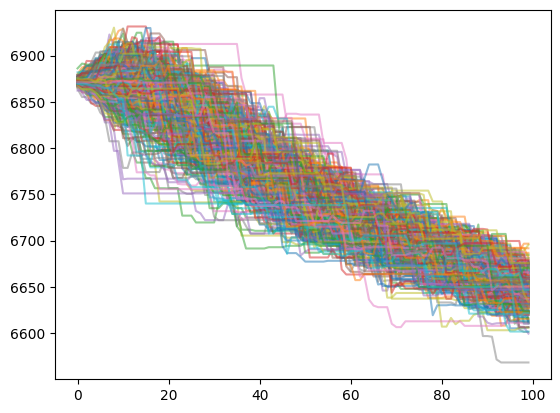

In [9]:
# Let's construct an internal optimization for e in {250.0, 283.7, 284.2, 285.1, 287.0, 289.0}
internal_energies = [250.0, 283.7, 284.2, 285.1, 287.0, 289.0]
internal_objectives = [o for o in fitting_results.objectives if o.model.energy in internal_energies]

# Construct a global objective from the internal objectives
global_objective = fit.GlobalObjective(internal_objectives)

# Fit the global objective
fitter = fit.CurveFitter(global_objective)
fitter.initialise("jitter", random_state=12345)
fitter.sample(100)
plt.plot(-fitter.logpost, alpha=0.5)
plt.show()
fitter.reset()

In [ ]:
fitter.fit("differential_evolution", workers=CPU_COUNT//2, updating="deferred", x0=x0(fitter))

0it [00:00, ?it/s]

1696.697924501776: : 250it [1:36:10, 15.18s/it] 

In [ ]:
update_bounds(fitter, override_chain=True)
fitter.fit("L-BFGS-B")
update_bounds(fitter, override_chain=True)
fitter.fit("differential_evolution", workers=CPU_COUNT//2, updating="deferred", x0=x0(fitter))
update_bounds(fitter, override_chain=True)

0it [00:00, ?it/s]

1751.063708021001: : 1it [00:08,  8.30s/it]
1741.2224120585201: : 90it [10:26,  6.96s/it]


In [ ]:
fitter.initialise("jitter", random_state=12345)
fitter.sample(200)
update_bounds(fitter)
fitter.reset()
fitter.sample(1000)
print(global_objective.varying_parameters())

 12%|█▏        | 124/1000 [21:37<2:13:24,  9.14s/it]

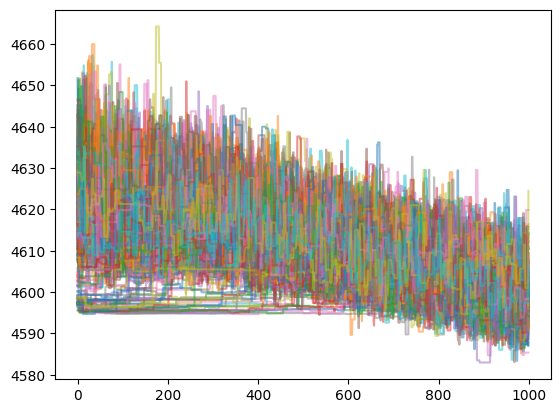

In [ ]:
plt.plot(-fitter.logpost, alpha=0.5)
plt.show()

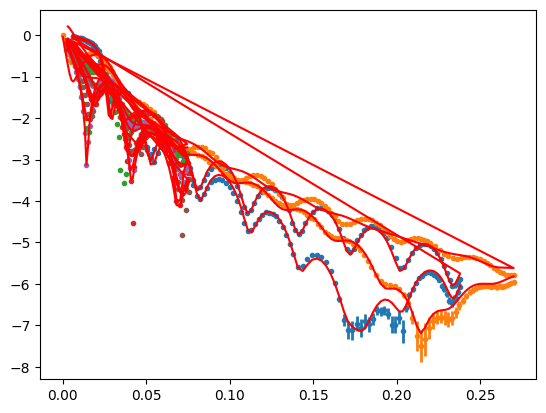

In [ ]:
global_objective.plot()
plt.show()
global_objective.corner()
plt.show()

In [ ]:
with open("fitting_results_fixed_4.pkl", "wb") as f:
    pickle.dump(fitting_results, f)